In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime as dt

In [3]:
df = pd.read_csv("datasets/feinstaub_reformatted.csv")

In [4]:
df.head()

,Zeitstempel,PM2.5,Station Name,Station Koordinaten,Station ID,longitude,latitude,year,month,day,hour,minute
0,2021-07-28 14:00:00+02:00,4.6,Basel Erlenparkweg 55 (Lange Erlen),"47.5747593107,7.6058294407",sep40a5-0c272b,47.574759,7.605829,2021,7,28,14,0
1,2021-07-28 12:30:00+02:00,4.7,Basel Erlenparkweg 55 (Lange Erlen),"47.5747593107,7.6058294407",sep40a5-0c272b,47.574759,7.605829,2021,7,28,12,30
2,2021-07-28 11:30:00+02:00,5.0,Basel Erlenparkweg 55 (Lange Erlen),"47.5747593107,7.6058294407",sep40a5-0c272b,47.574759,7.605829,2021,7,28,11,30
3,2021-07-28 09:00:00+02:00,7.7,Basel Erlenparkweg 55 (Lange Erlen),"47.5747593107,7.6058294407",sep40a5-0c272b,47.574759,7.605829,2021,7,28,9,0
4,2021-07-28 08:30:00+02:00,7.8,Basel Erlenparkweg 55 (Lange Erlen),"47.5747593107,7.6058294407",sep40a5-0c272b,47.574759,7.605829,2021,7,28,8,30


In [6]:
len(df["Station ID"].unique())

10

In [7]:
len(df["Station Koordinaten"].unique())

10

In [8]:
uni = df["Station ID"].unique()

In [12]:
# find koords of unique
koords = df["Station Koordinaten"].drop_duplicates()

In [13]:
koords

0         47.5747593107,7.6058294407
6800      47.5714377236,7.6015397419
13354    47.5410990173,7.58323739459
19859    47.5670041324,7.59474901758
20694    47.5658961775,7.58209528605
29899    47.5587440026,7.60409188116
46538    47.5396673864,7.59825519952
46831    47.5490470544,7.61144779923
55064    47.5552853555,7.61369999458
68106    47.5825513344,7.59010223938
Name: Station Koordinaten, dtype: object

In [27]:
longs = []
lats = []

for item in koords:
    s = item.split(",")
    longs.append(float(s[0]))
    lats.append(float(s[1]))

In [28]:
BBox = (min(longs), max(longs), min(lats), max(lats))

In [29]:
BBox

(47.5396673864, 47.5825513344, 7.58209528605, 7.61369999458)

In [30]:
type(BBox[0])

float

In [31]:
basel = plt.imread("maps/basel_feinstaub.png")

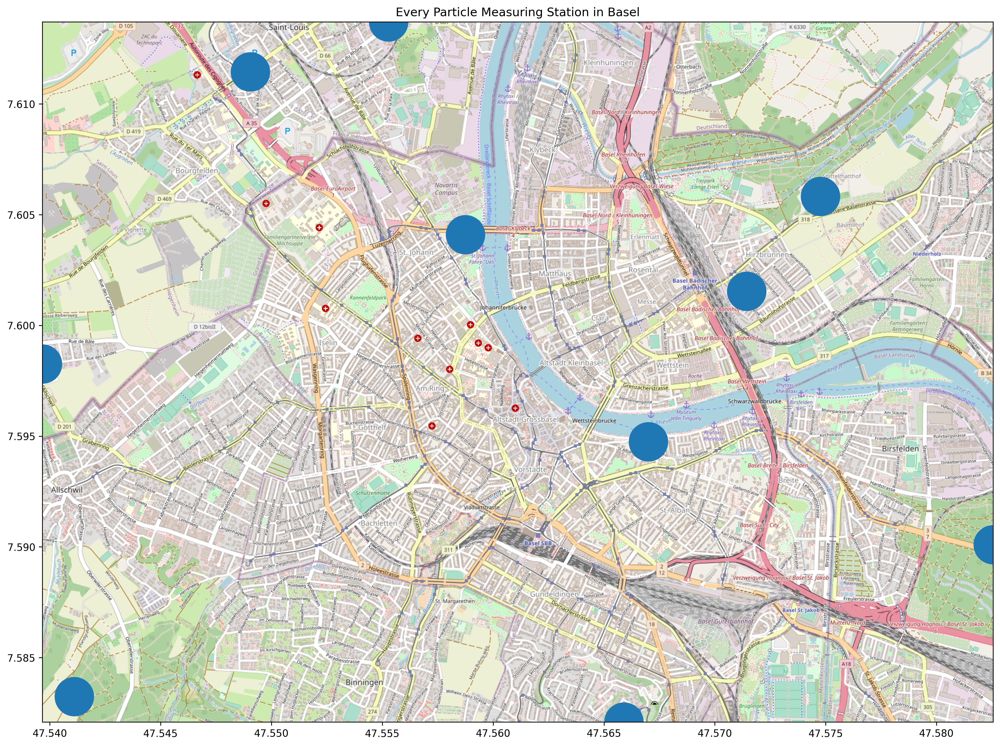

In [32]:
plt.figure(figsize=(20, 13), dpi=300)
plt.scatter(longs, lats, marker="o", s=1500, zorder=1)
plt.title("Every Particle Measuring Station in Basel")
plt.xlim(BBox[0], BBox[1])
plt.ylim(BBox[2], BBox[3])

plt.imshow(basel, zorder=0, extent = BBox, aspect="equal")
plt.show()